In [1]:
# %%
import os
os.environ["GLOG_minloglevel"] = "3"
os.environ["TF_CPP_MIN_LOG_LEVEL"] = "3"
os.environ["MEDIAPIPE_DISABLE_LOG"] = "1"
os.environ["PROTOCOL_BUFFERS_PYTHON_IMPLEMENTATION"] = "python"

# %%
import warnings
warnings.filterwarnings('ignore')
import contextlib

# %% [markdown]
# ## 1. Load data

# %%
import os
import sys
import torch
import numpy as np
from torch import nn
from torch.utils.data import DataLoader
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt

from modules.dataset import *
from modules.hand_visualizations import extract_hand_landmarks

In [3]:
DATASET_PATH = "/Users/christina/code/RockPaperScissors/2"

# ## 2. Model Definition

class RPSModel(nn.Module):
    def __init__(self, activation_func: str = "relu"):
        super().__init__()
        
        activation = self.get_activation(activation_func)

        self.net = nn.Sequential(
            nn.Linear(63, 128),
            activation,
            nn.Linear(128, 64),
            activation,
            nn.Linear(64, 3)
        )

    def forward(self, x):
        return self.net(x)

    def get_activation(self, name):
        name = name.lower()
        if name == "relu":
            return nn.ReLU()
        elif name == "tanh":
            return nn.Tanh()
        elif name == "sigmoid":
            return nn.Sigmoid()
        elif name == "leakyrelu":
            return nn.LeakyReLU()
        elif name == "gelu":
            return nn.GELU()
        else:
            raise ValueError(f"Unsupported activation function: {name}")

# %%

# Load dataset and split into train/test sets
def load_dataset(dataset_dir):
    image_paths, labels = [], []

    for label_name in LABELS:
        class_dir = os.path.join(dataset_dir, label_name)
        for img in os.listdir(class_dir):
            image_paths.append(os.path.join(class_dir, img))
            labels.append(LABELS[label_name])

    return image_paths, labels

def split_dataset(image_paths, labels, test_size=0.2, random_state=42):
    return train_test_split(image_paths, labels, test_size=test_size, random_state=random_state)

# Training
def train(model, loader, criterion, optimizer):
    model.train()
    total_loss, correct = 0.0, 0

    for x, y in loader:
        optimizer.zero_grad()
        out = model(x)
        loss = criterion(out, y)
        loss.backward()
        optimizer.step()

        total_loss += loss.item()
        correct += (out.argmax(1) == y).sum().item()

    acc = correct / len(loader.dataset)
    return total_loss / len(loader), acc


# Evaluation
def evaluate(model, loader):
    model.eval()
    correct = 0
    with torch.no_grad():
        for x, y in loader:
            preds = model(x).argmax(1)
            correct += (preds == y).sum().item()
    return correct / len(loader.dataset)


# Visualization
def visualize_prediction(model, image_path, save=False):
    feature = extract_hand_landmarks(image_path)
    if feature is not None:
        x = torch.tensor(feature, dtype=torch.float32).unsqueeze(0)
        pred = model(x).argmax(1).item()
        label = list(LABELS.keys())[pred]

        image = plt.imread(image_path)
        plt.imshow(image)
        plt.title(f"Predicted: {label}")
        plt.axis('off')
        if save:
            plt.savefig(f"prediction_{label}.png")
        else: 
            plt.show()
    else:
        print("No hand landmarks detected.")


In [12]:
ACTIVATIONS = ["relu", "tanh", "sigmoid", "leakyrelu", "gelu"]

dataset_dir = DATASET_PATH
print(f"Using dataset directory: {dataset_dir}")
image_paths, labels = load_dataset(dataset_dir)
train_paths, test_paths, train_labels, test_labels = split_dataset(image_paths, labels)
print(f"Train set size: {len(train_paths)}")
print(f"Test set size: {len(test_paths)}")
results = {}

for act in ACTIVATIONS:
    print(f"\n=== Training with activation: {act} ===")
    train_ds = RPSDataset(train_paths, train_labels)
    test_ds = RPSDataset(test_paths, test_labels)
    train_loader = DataLoader(train_ds, batch_size=32, shuffle=True)
    test_loader = DataLoader(test_ds, batch_size=32)

    model = RPSModel(activation_func=act)
    criterion = nn.CrossEntropyLoss()
    optimizer = torch.optim.Adam(model.parameters(), lr=0.001)

    train_accs, test_accs, train_losses = [], [], []
    for epoch in range(5):
        train_loss, train_acc = train(model, train_loader, criterion, optimizer)
        test_acc = evaluate(model, test_loader)
        train_losses.append(train_loss)
        train_accs.append(train_acc)
        test_accs.append(test_acc)
        print(f"Epoch {epoch + 1}: Loss={train_loss:.4f} | Train Acc={train_acc:.4f} | Test Acc={test_acc:.4f}")
    
    results[act] = {"train_acc": train_accs,  
                    "train_loss": train_losses, 
                    "test_acc": test_accs, 
                    "model": model, 
                    "test_paths": test_paths}


Using dataset directory: /Users/christina/code/RockPaperScissors/2
Train set size: 1750
Test set size: 438

=== Training with activation: relu ===


I0000 00:00:1752572342.015757   40836 gl_context.cc:369] GL version: 2.1 (2.1 Metal - 88), renderer: Apple M3 Pro
W0000 00:00:1752572342.023930  886854 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
W0000 00:00:1752572342.028127  886854 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
I0000 00:00:1752572342.057995   40836 gl_context.cc:369] GL version: 2.1 (2.1 Metal - 88), renderer: Apple M3 Pro
W0000 00:00:1752572342.062902  886869 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
W0000 00:00:1752572342.067085  886877 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
I0000 00:00:1752572342.098474   40836 gl_con

Epoch 1: Loss=0.9576 | Train Acc=0.7480 | Test Acc=0.8767


I0000 00:00:1752572419.226672   40836 gl_context.cc:369] GL version: 2.1 (2.1 Metal - 88), renderer: Apple M3 Pro
W0000 00:00:1752572419.230925  914075 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
W0000 00:00:1752572419.234480  914078 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
I0000 00:00:1752572419.262078   40836 gl_context.cc:369] GL version: 2.1 (2.1 Metal - 88), renderer: Apple M3 Pro
W0000 00:00:1752572419.266329  914088 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
W0000 00:00:1752572419.270034  914094 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
I0000 00:00:1752572419.298433   40836 gl_con

Epoch 2: Loss=0.4179 | Train Acc=0.9251 | Test Acc=0.9338


I0000 00:00:1752572496.799041   40836 gl_context.cc:369] GL version: 2.1 (2.1 Metal - 88), renderer: Apple M3 Pro
W0000 00:00:1752572496.803358  941081 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
W0000 00:00:1752572496.807137  941088 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
I0000 00:00:1752572496.836995   40836 gl_context.cc:369] GL version: 2.1 (2.1 Metal - 88), renderer: Apple M3 Pro
W0000 00:00:1752572496.845258  941092 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
W0000 00:00:1752572496.850630  941092 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
I0000 00:00:1752572496.880929   40836 gl_con

Epoch 3: Loss=0.1662 | Train Acc=0.9520 | Test Acc=0.9703


I0000 00:00:1752572574.800032   40836 gl_context.cc:369] GL version: 2.1 (2.1 Metal - 88), renderer: Apple M3 Pro
W0000 00:00:1752572574.804238  968145 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
W0000 00:00:1752572574.807970  968145 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
I0000 00:00:1752572574.835529   40836 gl_context.cc:369] GL version: 2.1 (2.1 Metal - 88), renderer: Apple M3 Pro
W0000 00:00:1752572574.839642  968159 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
W0000 00:00:1752572574.843347  968157 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
I0000 00:00:1752572574.870657   40836 gl_con

Epoch 4: Loss=0.1033 | Train Acc=0.9629 | Test Acc=0.9680


I0000 00:00:1752572653.095467   40836 gl_context.cc:369] GL version: 2.1 (2.1 Metal - 88), renderer: Apple M3 Pro
W0000 00:00:1752572653.100622  995333 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
W0000 00:00:1752572653.108088  995333 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
I0000 00:00:1752572653.140967   40836 gl_context.cc:369] GL version: 2.1 (2.1 Metal - 88), renderer: Apple M3 Pro
W0000 00:00:1752572653.145042  995346 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
W0000 00:00:1752572653.148720  995350 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
I0000 00:00:1752572653.175517   40836 gl_con

Epoch 5: Loss=0.0839 | Train Acc=0.9640 | Test Acc=0.9726

=== Training with activation: tanh ===


I0000 00:00:1752572730.893492   40836 gl_context.cc:369] GL version: 2.1 (2.1 Metal - 88), renderer: Apple M3 Pro
W0000 00:00:1752572730.897857 1022641 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
W0000 00:00:1752572730.902330 1022647 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
I0000 00:00:1752572730.930289   40836 gl_context.cc:369] GL version: 2.1 (2.1 Metal - 88), renderer: Apple M3 Pro
W0000 00:00:1752572730.938028 1022654 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
W0000 00:00:1752572730.946186 1022655 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
I0000 00:00:1752572730.977498   40836 gl_con

Epoch 1: Loss=0.7744 | Train Acc=0.7514 | Test Acc=0.9406


I0000 00:00:1752572806.648526   40836 gl_context.cc:369] GL version: 2.1 (2.1 Metal - 88), renderer: Apple M3 Pro
W0000 00:00:1752572806.652514 1049975 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
W0000 00:00:1752572806.657861 1049982 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
I0000 00:00:1752572806.685257   40836 gl_context.cc:369] GL version: 2.1 (2.1 Metal - 88), renderer: Apple M3 Pro
W0000 00:00:1752572806.689664 1049989 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
W0000 00:00:1752572806.693798 1049998 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
I0000 00:00:1752572806.733475   40836 gl_con

Epoch 2: Loss=0.2122 | Train Acc=0.9463 | Test Acc=0.9703


I0000 00:00:1752572883.324671   40836 gl_context.cc:369] GL version: 2.1 (2.1 Metal - 88), renderer: Apple M3 Pro
W0000 00:00:1752572883.328626 1076906 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
W0000 00:00:1752572883.332703 1076903 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
I0000 00:00:1752572883.349976   40836 gl_context.cc:369] GL version: 2.1 (2.1 Metal - 88), renderer: Apple M3 Pro
W0000 00:00:1752572883.353961 1076918 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
W0000 00:00:1752572883.357556 1076918 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
I0000 00:00:1752572883.384835   40836 gl_con

Epoch 3: Loss=0.0973 | Train Acc=0.9634 | Test Acc=0.9726


I0000 00:00:1752572959.047138   40836 gl_context.cc:369] GL version: 2.1 (2.1 Metal - 88), renderer: Apple M3 Pro
W0000 00:00:1752572959.052550 1104571 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
W0000 00:00:1752572959.056452 1104576 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
I0000 00:00:1752572959.084585   40836 gl_context.cc:369] GL version: 2.1 (2.1 Metal - 88), renderer: Apple M3 Pro
W0000 00:00:1752572959.088562 1104583 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
W0000 00:00:1752572959.092207 1104583 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
I0000 00:00:1752572959.119851   40836 gl_con

Epoch 4: Loss=0.0805 | Train Acc=0.9629 | Test Acc=0.9726


I0000 00:00:1752573034.921681   40836 gl_context.cc:369] GL version: 2.1 (2.1 Metal - 88), renderer: Apple M3 Pro
W0000 00:00:1752573034.926189 1131685 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
W0000 00:00:1752573034.930685 1131695 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
I0000 00:00:1752573034.947053   40836 gl_context.cc:369] GL version: 2.1 (2.1 Metal - 88), renderer: Apple M3 Pro
W0000 00:00:1752573034.950943 1131699 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
W0000 00:00:1752573034.954527 1131701 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
I0000 00:00:1752573034.981096   40836 gl_con

Epoch 5: Loss=0.0737 | Train Acc=0.9623 | Test Acc=0.9726

=== Training with activation: sigmoid ===


I0000 00:00:1752573111.263661   40836 gl_context.cc:369] GL version: 2.1 (2.1 Metal - 88), renderer: Apple M3 Pro
W0000 00:00:1752573111.267680 1158946 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
W0000 00:00:1752573111.272084 1158946 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
I0000 00:00:1752573111.299591   40836 gl_context.cc:369] GL version: 2.1 (2.1 Metal - 88), renderer: Apple M3 Pro
W0000 00:00:1752573111.303700 1158960 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
W0000 00:00:1752573111.307375 1158960 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
I0000 00:00:1752573111.333916   40836 gl_con

Epoch 1: Loss=1.0974 | Train Acc=0.3577 | Test Acc=0.3630


I0000 00:00:1752573187.089231   40836 gl_context.cc:369] GL version: 2.1 (2.1 Metal - 88), renderer: Apple M3 Pro
W0000 00:00:1752573187.093935 1185752 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
W0000 00:00:1752573187.097514 1185755 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
I0000 00:00:1752573187.126001   40836 gl_context.cc:369] GL version: 2.1 (2.1 Metal - 88), renderer: Apple M3 Pro
W0000 00:00:1752573187.133605 1185763 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
W0000 00:00:1752573187.140303 1185762 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
I0000 00:00:1752573187.170946   40836 gl_con

Epoch 2: Loss=1.0646 | Train Acc=0.4709 | Test Acc=0.4703


I0000 00:00:1752573263.442553   40836 gl_context.cc:369] GL version: 2.1 (2.1 Metal - 88), renderer: Apple M3 Pro
W0000 00:00:1752573263.447476 1212529 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
W0000 00:00:1752573263.452519 1212529 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
I0000 00:00:1752573263.479723   40836 gl_context.cc:369] GL version: 2.1 (2.1 Metal - 88), renderer: Apple M3 Pro
W0000 00:00:1752573263.484074 1212541 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
W0000 00:00:1752573263.488140 1212545 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
I0000 00:00:1752573263.517532   40836 gl_con

Epoch 3: Loss=0.9622 | Train Acc=0.6491 | Test Acc=0.7968


W0000 00:00:1752573340.832987 1239232 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
W0000 00:00:1752573340.837358 1239235 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
I0000 00:00:1752573340.864074   40836 gl_context.cc:369] GL version: 2.1 (2.1 Metal - 88), renderer: Apple M3 Pro
W0000 00:00:1752573340.868810 1239244 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
W0000 00:00:1752573340.873336 1239244 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
I0000 00:00:1752573340.897735   40836 gl_context.cc:369] GL version: 2.1 (2.1 Metal - 88), renderer: Apple M3 Pro
W0000 00:00:1752573340.902108 1239256 infere

Epoch 4: Loss=0.7597 | Train Acc=0.7571 | Test Acc=0.7580


I0000 00:00:1752573417.164196   40836 gl_context.cc:369] GL version: 2.1 (2.1 Metal - 88), renderer: Apple M3 Pro
W0000 00:00:1752573417.168707 1265843 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
W0000 00:00:1752573417.172381 1265851 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
I0000 00:00:1752573417.201666   40836 gl_context.cc:369] GL version: 2.1 (2.1 Metal - 88), renderer: Apple M3 Pro
W0000 00:00:1752573417.205712 1265855 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
W0000 00:00:1752573417.209483 1265855 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
I0000 00:00:1752573417.237106   40836 gl_con

Epoch 5: Loss=0.6090 | Train Acc=0.7714 | Test Acc=0.8174

=== Training with activation: leakyrelu ===


I0000 00:00:1752573494.088451   40836 gl_context.cc:369] GL version: 2.1 (2.1 Metal - 88), renderer: Apple M3 Pro
W0000 00:00:1752573494.096009 1293008 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
W0000 00:00:1752573494.100264 1293013 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
I0000 00:00:1752573494.133885   40836 gl_context.cc:369] GL version: 2.1 (2.1 Metal - 88), renderer: Apple M3 Pro
W0000 00:00:1752573494.142140 1293018 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
W0000 00:00:1752573494.147085 1293018 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
I0000 00:00:1752573494.177123   40836 gl_con

Epoch 1: Loss=0.9252 | Train Acc=0.7126 | Test Acc=0.8539


I0000 00:00:1752573571.944721   40836 gl_context.cc:369] GL version: 2.1 (2.1 Metal - 88), renderer: Apple M3 Pro
W0000 00:00:1752573571.949171 1319822 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
W0000 00:00:1752573571.954454 1319820 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
I0000 00:00:1752573571.981130   40836 gl_context.cc:369] GL version: 2.1 (2.1 Metal - 88), renderer: Apple M3 Pro
W0000 00:00:1752573571.985165 1319836 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
W0000 00:00:1752573571.989051 1319836 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
I0000 00:00:1752573572.019148   40836 gl_con

Epoch 2: Loss=0.3381 | Train Acc=0.9257 | Test Acc=0.9543


I0000 00:00:1752573650.823897   40836 gl_context.cc:369] GL version: 2.1 (2.1 Metal - 88), renderer: Apple M3 Pro
W0000 00:00:1752573650.828266 1346529 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
W0000 00:00:1752573650.832224 1346526 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
I0000 00:00:1752573650.860002   40836 gl_context.cc:369] GL version: 2.1 (2.1 Metal - 88), renderer: Apple M3 Pro
W0000 00:00:1752573650.864255 1346541 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
W0000 00:00:1752573650.867880 1346541 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
I0000 00:00:1752573650.895644   40836 gl_con

Epoch 3: Loss=0.1383 | Train Acc=0.9474 | Test Acc=0.9680


I0000 00:00:1752573728.713702   40836 gl_context.cc:369] GL version: 2.1 (2.1 Metal - 88), renderer: Apple M3 Pro
W0000 00:00:1752573728.718555 1373728 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
W0000 00:00:1752573728.723747 1373728 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
I0000 00:00:1752573728.752629   40836 gl_context.cc:369] GL version: 2.1 (2.1 Metal - 88), renderer: Apple M3 Pro
W0000 00:00:1752573728.767868 1373740 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
W0000 00:00:1752573728.774543 1373741 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
I0000 00:00:1752573728.804210   40836 gl_con

Epoch 4: Loss=0.0925 | Train Acc=0.9634 | Test Acc=0.9726


I0000 00:00:1752573806.370135   40836 gl_context.cc:369] GL version: 2.1 (2.1 Metal - 88), renderer: Apple M3 Pro
W0000 00:00:1752573806.376115 1400315 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
W0000 00:00:1752573806.381119 1400315 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
I0000 00:00:1752573806.398544   40836 gl_context.cc:369] GL version: 2.1 (2.1 Metal - 88), renderer: Apple M3 Pro
W0000 00:00:1752573806.402788 1400325 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
W0000 00:00:1752573806.406417 1400325 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
I0000 00:00:1752573806.432693   40836 gl_con

Epoch 5: Loss=0.0843 | Train Acc=0.9623 | Test Acc=0.9726

=== Training with activation: gelu ===


I0000 00:00:1752573884.282640   40836 gl_context.cc:369] GL version: 2.1 (2.1 Metal - 88), renderer: Apple M3 Pro
W0000 00:00:1752573884.287924 1426966 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
W0000 00:00:1752573884.291799 1426973 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
I0000 00:00:1752573884.322628   40836 gl_context.cc:369] GL version: 2.1 (2.1 Metal - 88), renderer: Apple M3 Pro
W0000 00:00:1752573884.327442 1426978 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
W0000 00:00:1752573884.331145 1426978 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
I0000 00:00:1752573884.359160   40836 gl_con

Epoch 1: Loss=0.9389 | Train Acc=0.6863 | Test Acc=0.8105


Context leak detected, msgtracer returned -1
I0000 00:00:1752573962.210990   40836 gl_context.cc:369] GL version: 2.1 (2.1 Metal - 88), renderer: Apple M3 Pro
W0000 00:00:1752573962.215171 1453618 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
W0000 00:00:1752573962.218866 1453621 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
Context leak detected, msgtracer returned -1
I0000 00:00:1752573962.245449   40836 gl_context.cc:369] GL version: 2.1 (2.1 Metal - 88), renderer: Apple M3 Pro
W0000 00:00:1752573962.249461 1453631 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
W0000 00:00:1752573962.253352 1453632 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature infer

Epoch 2: Loss=0.3266 | Train Acc=0.9017 | Test Acc=0.9429


Context leak detected, msgtracer returned -1
I0000 00:00:1752574040.433174   40836 gl_context.cc:369] GL version: 2.1 (2.1 Metal - 88), renderer: Apple M3 Pro
W0000 00:00:1752574040.438089 1480281 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
W0000 00:00:1752574040.443695 1480279 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
Context leak detected, msgtracer returned -1
I0000 00:00:1752574040.471682   40836 gl_context.cc:369] GL version: 2.1 (2.1 Metal - 88), renderer: Apple M3 Pro
W0000 00:00:1752574040.476767 1480293 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
W0000 00:00:1752574040.480823 1480300 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature infer

Epoch 3: Loss=0.1338 | Train Acc=0.9474 | Test Acc=0.9658


I0000 00:00:1752574118.664497   40836 gl_context.cc:369] GL version: 2.1 (2.1 Metal - 88), renderer: Apple M3 Pro
W0000 00:00:1752574118.669116 1506926 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
W0000 00:00:1752574118.672949 1506927 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
I0000 00:00:1752574118.693613   40836 gl_context.cc:369] GL version: 2.1 (2.1 Metal - 88), renderer: Apple M3 Pro
W0000 00:00:1752574118.697736 1506937 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
W0000 00:00:1752574118.701417 1506935 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
I0000 00:00:1752574118.730023   40836 gl_con

Epoch 4: Loss=0.0900 | Train Acc=0.9554 | Test Acc=0.9703


I0000 00:00:1752574197.691332   40836 gl_context.cc:369] GL version: 2.1 (2.1 Metal - 88), renderer: Apple M3 Pro
W0000 00:00:1752574197.695830 1533817 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
W0000 00:00:1752574197.699972 1533828 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
I0000 00:00:1752574197.728495   40836 gl_context.cc:369] GL version: 2.1 (2.1 Metal - 88), renderer: Apple M3 Pro
W0000 00:00:1752574197.732669 1533832 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
W0000 00:00:1752574197.736354 1533832 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
I0000 00:00:1752574197.763290   40836 gl_con

Epoch 5: Loss=0.0791 | Train Acc=0.9651 | Test Acc=0.9726


I0000 00:00:1752574276.633342   40836 gl_context.cc:369] GL version: 2.1 (2.1 Metal - 88), renderer: Apple M3 Pro
W0000 00:00:1752574276.638046 1560787 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
W0000 00:00:1752574276.642959 1560787 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
I0000 00:00:1752574276.670499   40836 gl_context.cc:369] GL version: 2.1 (2.1 Metal - 88), renderer: Apple M3 Pro
W0000 00:00:1752574276.674541 1560800 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
W0000 00:00:1752574276.678105 1560800 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
I0000 00:00:1752574276.705446   40836 gl_con

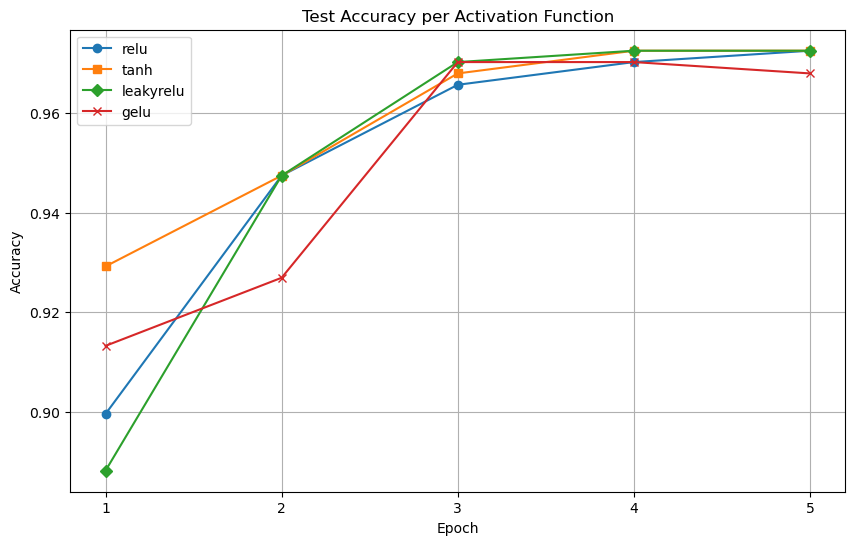

In [10]:
# Plot results
plt.figure(figsize=(10,6))

markers = ['o', 's', '^', 'D', 'x']
for i, act in enumerate(ACTIVATIONS):
    if act == "sigmoid":
        continue
    plt.plot(results[act]["test_acc"], label=f"{act}", marker=markers[i % len(markers)])

plt.xlabel("Epoch")
plt.ylabel("Accuracy")
plt.title("Test Accuracy per Activation Function")
plt.xticks(range(len(results[ACTIVATIONS[0]]["test_acc"])), range(1, len(results[ACTIVATIONS[0]]["test_acc"]) + 1))
plt.grid()
plt.legend(loc="best")
plt.show()
#plt.savefig("test_accuracy_per_activation.png")

In [ ]:
# Visualizations
for act in ACTIVATIONS:
    print(f"\nExample predictions for activation: {act}")
    model = results[act]["model"]
    test_paths = results[act]["test_paths"]
    for i in range(2):  # Show 2 examples per activation
        # visualize_prediction(model, test_paths[i], save=True)
        visualize_prediction(model, test_paths[i])

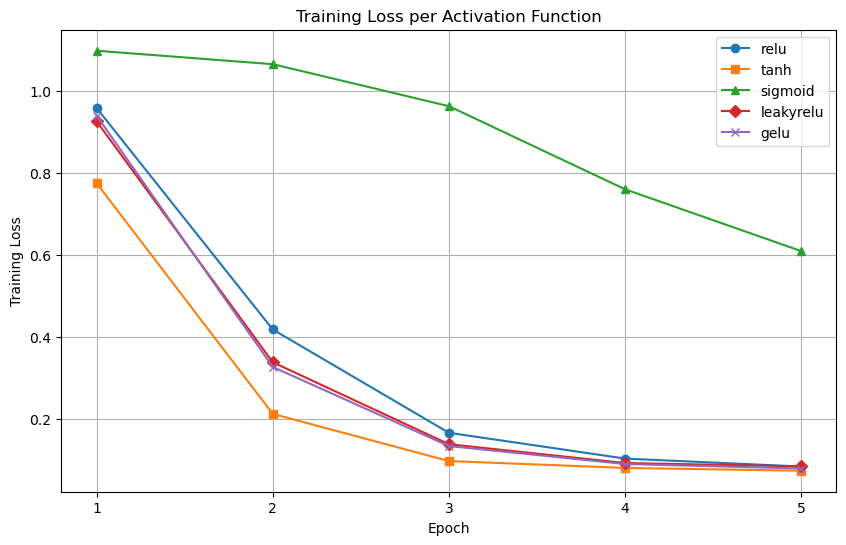

In [14]:
plt.figure(figsize=(10,6))
for i, act in enumerate(ACTIVATIONS):
    #if act == "sigmoid":
    #    continue
    plt.plot(results[act]["train_loss"], label=f"{act}", marker=markers[i % len(markers)])

plt.xlabel("Epoch")
plt.ylabel("Training Loss")
plt.title("Training Loss per Activation Function")
plt.xticks(range(len(results[ACTIVATIONS[0]]["train_loss"])), range(1, len(results[ACTIVATIONS[0]]["train_loss"]) + 1))
plt.grid()
plt.legend(loc="best")
plt.show()
#plt.savefig("train_loss_per_activation.png")

Plot images with landmarks

I0000 00:00:1752586837.499508   40836 gl_context.cc:369] GL version: 2.1 (2.1 Metal - 88), renderer: Apple M3 Pro
W0000 00:00:1752586837.506513 1670568 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
W0000 00:00:1752586837.511762 1670568 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.


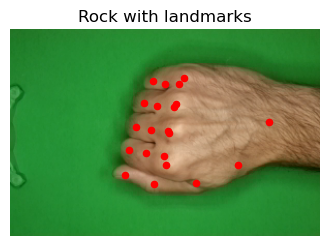

I0000 00:00:1752586837.591952   40836 gl_context.cc:369] GL version: 2.1 (2.1 Metal - 88), renderer: Apple M3 Pro
W0000 00:00:1752586837.597430 1670579 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
W0000 00:00:1752586837.603244 1670587 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.


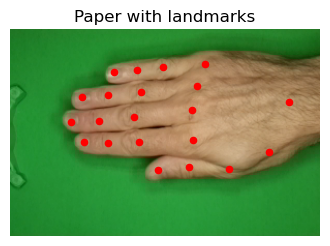

I0000 00:00:1752586837.682732   40836 gl_context.cc:369] GL version: 2.1 (2.1 Metal - 88), renderer: Apple M3 Pro
W0000 00:00:1752586837.688587 1670599 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
W0000 00:00:1752586837.693556 1670592 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.


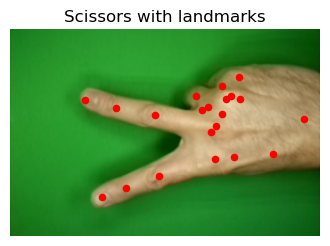

In [22]:
import matplotlib.pyplot as plt
from modules.dataset import LABELS
from modules.hand_visualizations import extract_hand_landmarks

# Assuming DATASET_PATH points to your dataset directory
class_names = list(LABELS.keys())
sample_images = {}

# Find one image path for each class
for class_name in class_names:
    class_dir = os.path.join(DATASET_PATH, class_name)
    ctmp = 0
    for img_name in os.listdir(class_dir):
        ctmp += 1
        if ctmp > 2:  # Only take the first image found
            img_path = os.path.join(class_dir, img_name)
            sample_images[class_name] = img_path
            break  # Take the first image found

# Plot images with landmarks
for class_name, img_path in sample_images.items():
    image = plt.imread(img_path)
    landmarks = extract_hand_landmarks(img_path)
    plt.figure(figsize=(4, 4))
    plt.imshow(image)
    if landmarks is not None:
        # landmarks is a flat array: [x1, y1, z1, x2, y2, z2, ...]
        xs = landmarks[0::3] * image.shape[1]  # scale x to image width
        ys = landmarks[1::3] * image.shape[0]  # scale y to image height
        plt.scatter(xs, ys, c='red', s=20)
    else:
        print(f"No landmarks found for {class_name} in {img_path}")
    plt.title(f"{class_name.capitalize()} with landmarks")
    plt.axis('off')
    plt.show()